# CS448 - Lab 3: Artificial Reverberation and Room Simulation


In this lab we will get some experience in simulating rooms digitally. We will design some simple reverbs using small filters and then work towards a more principled room simulator. You can use whichever sound you like for the following examples, usually a sound with sharp onsets is good for such experiments. One good example is the drum loop [ https://drive.google.com/uc?export=download&id=16mqI3xFN00AK5bP5k1VYJiEfH7ghHHSf ]

## Part 1. Designing simple reverb using filters

The simplest forms of reverbs can be designed using simple delays, comb and allpass filters. We will design one of each to get started.

a) A room with a single wall. For this reverb we will assume that we have a room that only has one reflective wall as shown below. Design a filter that simulates what the microphone will record. Figure out the right filter in the case where $d_i = [0.2, 1]$ meters, and in the case where $d_i = [2, 10]$ meters. Let me know what the differences between these sounds are. To keep things simple, round the delays to an integer number and make up an approximate gain loss due to propagation and the wall bounce.

In [2]:
import numpy as np
import soundfile as sf
from scipy import signal
import matplotlib.pyplot as plt
sound_speed = 340 # m/s

# Make a sound player function that plays array "x" with a sample rate "rate", and labels it with "label"
def play_sound( x, rate=8000, label=''):
    from IPython.display import display, Audio, HTML
    if label == '':
        display( Audio( x, rate=rate))
    else:
        display( HTML( 
        '<style> table, th, td {border: 0px; }</style> <table><tr><td>' + label + 
        '</td><td>' + Audio( x, rate=rate)._repr_html_()[3:] + '</td></tr></table>'
        ))

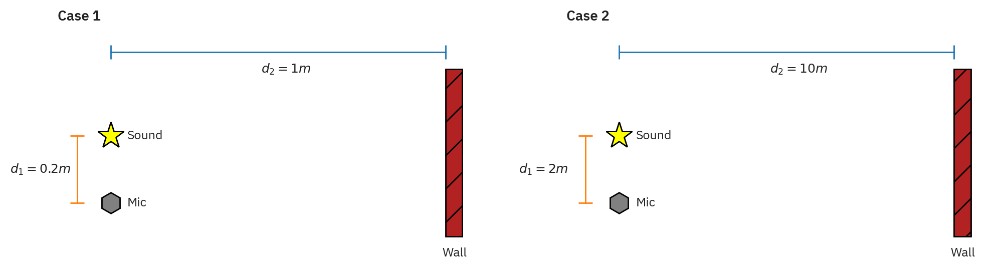

In [129]:
from matplotlib.pylab import gca, gcf, figure
from matplotlib.patches import Rectangle
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

figure( figsize=(12,3), facecolor='w')
gcf().add_subplot( 1, 2, 1, title='Case 1', frameon=False, xticks=[], yticks=[])
gca().plot( 0, 0, 'h', color='grey', markeredgecolor='k', markersize=15)
gca().plot( 0, .2, '*', color='yellow', markeredgecolor='k', markersize=20)
gca().plot( [0,1], [.45,.45], marker='|', markersize=10)
gca().plot( [-.1,-.1], [0,.2], marker='_', markersize=10)
gca().add_patch( Rectangle( (1,-.1), .05, .5, facecolor='firebrick', edgecolor='k', hatch='/'))
[gca().text(x+.05,y,t,va='center',ha='left') 
    for x,y,t in zip( [0,0,-.35,.4,.94], [0,.2,.1,.4,-.15], ['Mic','Sound','$d_1=0.2m$', '$d_2=1m$', 'Wall'])]
gca().axis( 'equal')

gcf().add_subplot( 1, 2, 2, title='Case 2', frameon=False, xticks=[], yticks=[])
gca().plot( 0, 0, 'h', color='grey', markeredgecolor='k', markersize=15)
gca().plot( 0, .2, '*', color='yellow', markeredgecolor='k', markersize=20)
gca().plot( [0,1], [.45,.45], marker='|', markersize=10)
gca().plot( [-.1,-.1], [0,.2], marker='_', markersize=10)
gca().add_patch( Rectangle( (1,-.1), .05, .5, facecolor='firebrick', edgecolor='k', hatch='/'))
[gca().text(x+.05,y,t,va='center',ha='left') 
    for x,y,t in zip( [0,0,-.35,.4,.94], [0,.2,.1,.4,-.15], ['Mic','Sound','$d_1=2m$', '$d_2=10m$', 'Wall'])]
gca().axis( 'equal');

"di = [0.2,1], One wall reverbed sound"


"di = [2,10], One wall reverbed sound"


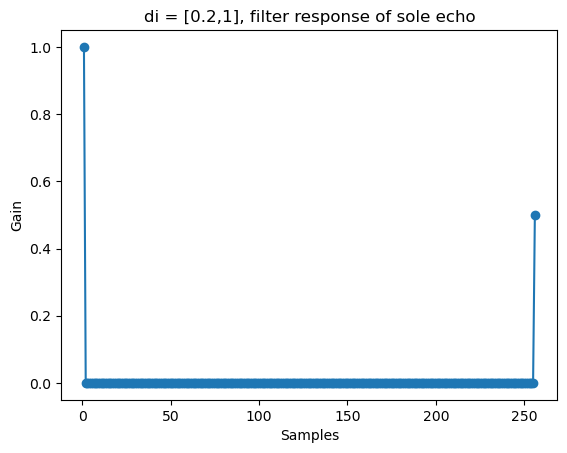

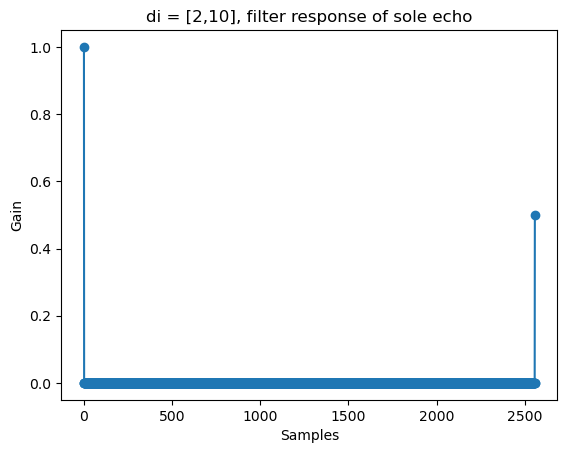

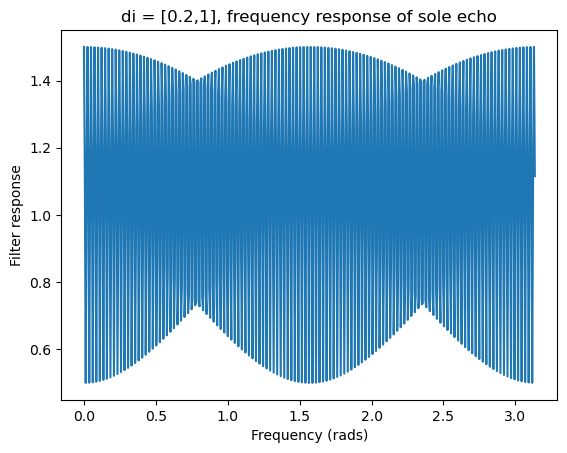

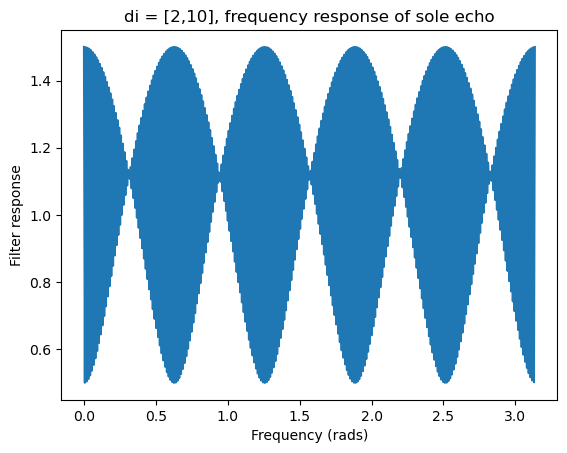

In [3]:
sound, sample_rate = sf.read('loop.wav')
#produce a filter
def produce_filter(distance_to_mic,distance_to_wall,gain_loss):
    reverb_length = 2*np.sqrt(distance_to_wall**2+(distance_to_mic/2)**2)
    # distance difference of direct sound and reverbed sound
    distance_difference = reverb_length - distance_to_mic
    time_difference = distance_difference/sound_speed
    sample_points_between_direct_and_reverbed = int(time_difference*sample_rate)+1
    filter = np.zeros(sample_points_between_direct_and_reverbed)
    filter[0] = 1
    filter[sample_points_between_direct_and_reverbed-1] = gain_loss
    return filter

def get_filter_response(filter,title,flag=0):
    if flag == 0:
        x = [i for i in range(1,(len(filter)+1))]
        plt.scatter(x,filter)
        plt.plot(x,filter)
    elif flag == 1:
        if len(filter) == 1:
            samples = np.zeros(len(filter[0])*12)
            samples[0] = 1
            x = [i for i in range(1,(len(samples)+1))]
            plt.plot(signal.lfilter([1],filter[0],samples))
            plt.scatter(x,signal.lfilter([1],filter[0],samples))
        else:
            samples = np.zeros(len(filter[1])*12)
            samples[0] = 1
            x = [i for i in range(1,(len(samples)+1))]
            plt.plot(x,signal.lfilter(filter[0],filter[1],samples))
            plt.scatter(x,signal.lfilter(filter[0],filter[1],samples))

    plt.xlabel("Samples")
    plt.ylabel("Gain")
    plt.title(title)

def get_frequency_response(filter,title,flag=0):
    local_flag = 0
    if flag==0:
        w, h = signal.freqz(filter)
    elif flag == 1:
        if len(filter) == 1:
            w, h = signal.freqz([1], filter[0])
        else:
            w, h = signal.freqz(filter[0],filter[1])
            local_flag = 1
    
    plt.plot(w, abs(h))
    plt.title(title)
    plt.xlabel('Frequency (rads)')
    plt.ylabel('Filter response')
    if local_flag == 1:
        plt.ylim(-2,2)

distance_to_mic = 0.2
distance_to_wall = 1
gain_loss = 0.5

#generate filter
one_wall_filter1 = produce_filter(distance_to_mic,distance_to_wall,gain_loss)
one_wall_filter2 = produce_filter(2,10,0.5)
#convolution
reverbed_sound = signal.convolve(sound,one_wall_filter1)
play_sound(reverbed_sound,sample_rate,"di = [0.2,1], One wall reverbed sound")
reverbed_sound2 = signal.convolve(sound,one_wall_filter2)
play_sound(reverbed_sound2,sample_rate,"di = [2,10], One wall reverbed sound")
#plot
plt.figure()
get_filter_response(one_wall_filter1,"di = [0.2,1], filter response of sole echo")
plt.figure()
get_filter_response(one_wall_filter2,"di = [2,10], filter response of sole echo")
plt.figure()
get_frequency_response(one_wall_filter1, "di = [0.2,1], frequency response of sole echo")
plt.figure()
get_frequency_response(one_wall_filter2, "di = [2,10], frequency response of sole echo")

b) Now we will use a room geometry as shown below. Design the proper filter again, for $d = 1$ meters and then for $d = 10$ meters. Comment on the audible differences between these two settings.

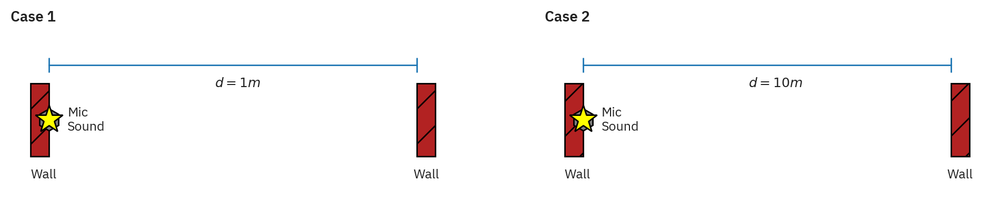

In [130]:
figure( figsize=(12,2), facecolor='w')
gcf().add_subplot( 1, 2, 1, title='Case 1', frameon=False, xticks=[], yticks=[])
gca().plot( 0, 0, 'h', color='grey', markeredgecolor='k', markersize=15)
gca().plot( 0, 0, '*', color='yellow', markeredgecolor='k', markersize=20)
gca().plot( [0,1], [.15,.15], marker='|', markersize=10)
gca().add_patch( Rectangle( (1,-.1), .05, .2, facecolor='firebrick', edgecolor='k', hatch='/'))
gca().add_patch( Rectangle( (0,-.1), -.05, .2, facecolor='firebrick', edgecolor='k', hatch='/'))
[gca().text(x+.05,y,t,va='center',ha='left') 
    for x,y,t in zip( [0,.4,.94,-.1], [0,.1,-.15,-.15], ['Mic\nSound','$d=1m$','Wall','Wall'])]
gca().axis( 'equal')

gcf().add_subplot( 1, 2, 2, title='Case 2', frameon=False, xticks=[], yticks=[])
gca().plot( 0, 0, 'h', color='grey', markeredgecolor='k', markersize=15)
gca().plot( 0, 0, '*', color='yellow', markeredgecolor='k', markersize=20)
gca().plot( [0,1], [.15,.15], marker='|', markersize=10)
gca().add_patch( Rectangle( (1,-.1), .05, .2, facecolor='firebrick', edgecolor='k', hatch='/'))
gca().add_patch( Rectangle( (0,-.1), -.05, .2, facecolor='firebrick', edgecolor='k', hatch='/'))
[gca().text(x+.05,y,t,va='center',ha='left') 
    for x,y,t in zip( [0,.4,.94,-.1], [0,.1,-.15,-.15], ['Mic\nSound','$d=10m$','Wall','Wall'])]
gca().axis( 'equal');

"Two walls, d=1m: comb filtered sound"


"Two walls, d=10m: comb filtered sound"


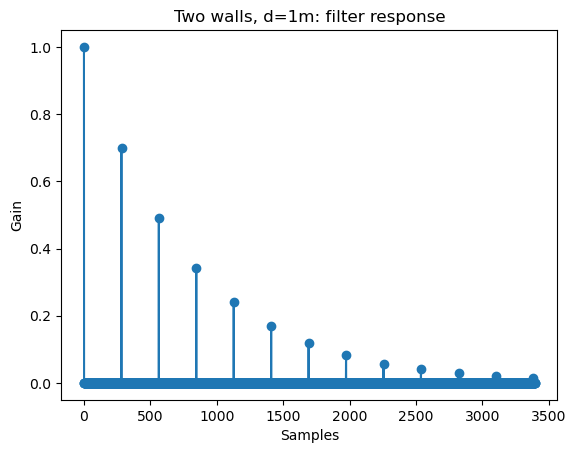

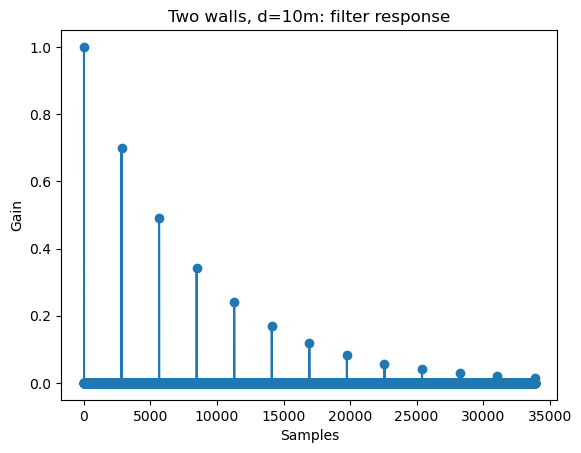

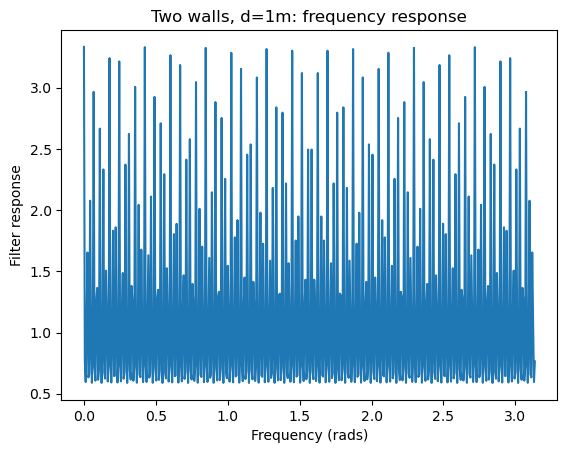

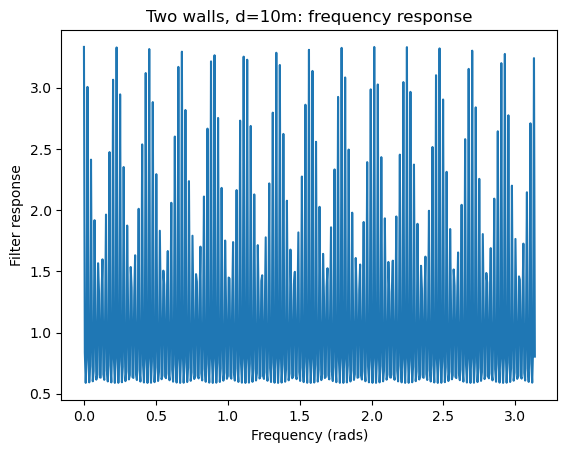

In [4]:
def comb_filter(distance, gain_loss):
    time_difference = 2*distance/sound_speed
    sample_points_between_direct_and_reverbed = int(time_difference*sample_rate)+1
    filter = np.zeros(sample_points_between_direct_and_reverbed)
    filter[0] = 1
    filter[sample_points_between_direct_and_reverbed-1] = -gain_loss
    return filter

#construct filters
two_walls_filter = comb_filter(1, 0.7)
comb_filtered_sound = signal.lfilter([1],two_walls_filter, sound)
two_walls_filter2 = comb_filter(10, 0.7)
comb_filtered_sound2 = signal.lfilter([1],two_walls_filter2, sound)
#play sound
play_sound(comb_filtered_sound, sample_rate,"Two walls, d=1m: comb filtered sound")
play_sound(comb_filtered_sound2, sample_rate,"Two walls, d=10m: comb filtered sound")

# impulse response
plt.figure()
get_filter_response([two_walls_filter],"Two walls, d=1m: filter response",flag=1 )
plt.figure()
get_filter_response([two_walls_filter2],"Two walls, d=10m: filter response",flag=1 )
#frequency response
plt.figure()
get_frequency_response([two_walls_filter], "Two walls, d=1m: frequency response", flag=1)
plt.figure()
get_frequency_response([two_walls_filter2], "Two walls, d=10m: frequency response", flag=1)

c) Since for small values of $d$ the output above gets its spectrum altered, we will use an allpass filter to make a more natural sounding echo pattern. Use the formulation shown in the lecture slides and compare that filter’s frequency response with the response from the filter in the section b) above.

"d = 1, allpass filter"


It can be seen that when using allpass filter, no frequency is filtered.
While using comb filter, its spectrum is indeed altered.


"d = 10, allpass filter"


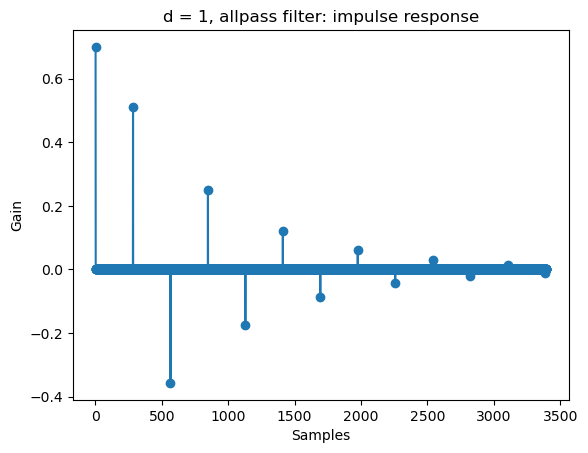

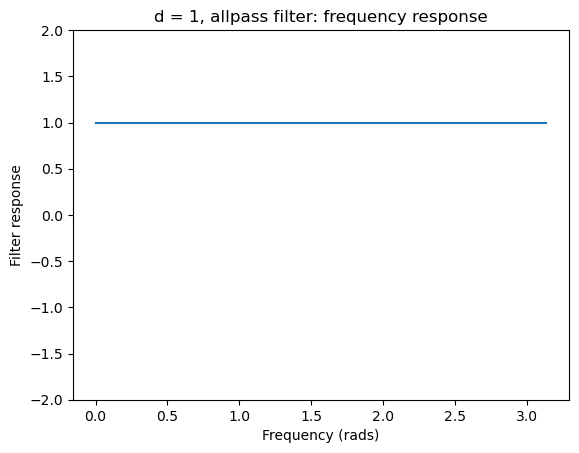

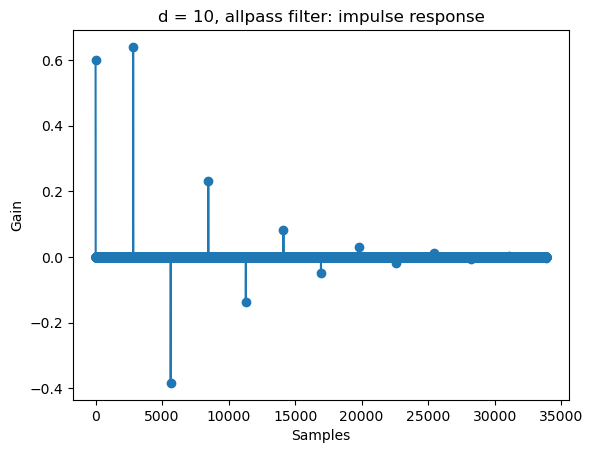

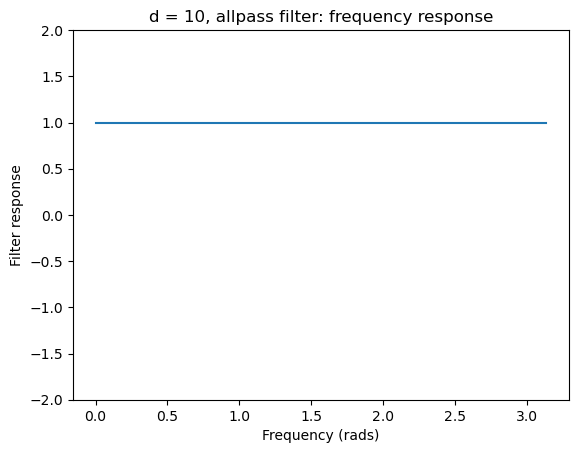

In [9]:
def allpass_filter(distance, gain_loss):
    time_difference = 2*distance/sound_speed
    sample_points = int(time_difference*sample_rate)+1
    b = np.zeros(sample_points)
    b[0] = gain_loss
    b[-1] = 1
    a = np.zeros(sample_points)
    a[0] = 1
    a[-1] = gain_loss
    return b,a
gain_loss = 0.7
b,a = allpass_filter(1,gain_loss)
#play sound
allpass_filtered_sound = signal.lfilter(b,a, sound)
play_sound(allpass_filtered_sound,sample_rate,"d = 1, allpass filter")
#impulse response
plt.figure()
get_filter_response([b,a],"d = 1, allpass filter: impulse response", flag=1)
#filter response
plt.figure()
get_frequency_response([b,a], "d = 1, allpass filter: frequency response", flag=1)
print("It can be seen that when using allpass filter, no frequency is filtered.")
print("While using comb filter, its spectrum is indeed altered.")

gain_loss = 0.6
b,a = allpass_filter(10,gain_loss)
#play sound
allpass_filtered_sound = signal.lfilter(b,a, sound)
play_sound(allpass_filtered_sound,sample_rate,"d = 10, allpass filter")
#impulse response
plt.figure()
get_filter_response([b,a],"d = 10, allpass filter: impulse response", flag=1)
#filter response
plt.figure()
get_frequency_response([b,a], "d = 10, allpass filter: frequency response", flag=1)

## Part 2. Schroeder reverberators

Now we will combine multiple filters to make a more serious sounding reverb. Implement the structure shown in slide 24 of the reverb lecture (the page is titled "*Wetness of reverb*").

Try to find the necessary parameters for the above structure that makes it sound as good as possible (not too busy, not too subtle). Hint: There is no right answer! Try a few things, see what sounds best and explain why you used the parameters you decided to use. As you come across some bad sounding cases, describe what the problem was.

In [6]:
num_of_combs = 3
combs_distances_range = [1,20]
combs_gains_range = [0.8,0.2]
combs_distances = np.linspace(combs_distances_range[0],combs_distances_range[1],num_of_combs)
combs_gains = np.linspace(combs_gains_range[0],combs_gains_range[1],num_of_combs)
allpass_distances = [3,8]
allpass_gains = [0.7,0.4]
dryness_level = 0.5
def wet_reverb(sound,sample_rate,dryness_level):
    #comb filter
    after_all_combed_sound = []
    combs_distances = np.linspace(combs_distances_range[0],combs_distances_range[1],num_of_combs)
    combs_gains = np.linspace(combs_gains_range[0],combs_gains_range[1],num_of_combs)
    for i in range(num_of_combs):
        filter = comb_filter(combs_distances[i],combs_gains[i])
        combed_sound = signal.lfilter([1], filter, sound)
        if i == 0:
            after_all_combed_sound = combed_sound
        else:
            after_all_combed_sound+=combed_sound
        print("Comb filter {}: distance(delay):{}, gain:{}".format(i+1,combs_distances[i],combs_gains[i]))
    print("Dryness level: {}".format(dryness_level))
    #allpass filter
    after_allpass_filter_sound = after_all_combed_sound
    for i in range(len(allpass_distances)):
        b,a = allpass_filter(allpass_distances[i],allpass_gains[i])
        after_allpass_filter_sound = signal.lfilter(b,a, after_allpass_filter_sound)
    #add dryness level
    final_sound = after_allpass_filter_sound+sound*dryness_level
    return final_sound

# wet_reverbed_sound = wet_reverb(sound,sample_rate,0.4)
# play_sound(wet_reverbed_sound, sample_rate,"Reverbed sound")


#parameters that I considered:

 1: delays
 
 2: gains

 3: dryness_level


In [7]:
count = 1
for combs_distances_range in [[0.1,10],[1,20]]:
    for combs_gains_range in [[0.8,0.2],[0.9,0.1]]:
        for dryness_level in [0.2,0.5,0.8]:
            print("Schroeder reverberator parameter test {}".format(count))
            wet_reverbed_sound = wet_reverb(sound,sample_rate,dryness_level)
            play_sound(wet_reverbed_sound, sample_rate,"Reverbed Sound: {}".format(count))
            count+=1
            print()

Schroeder reverberator parameter test 1
Comb filter 1: distance(delay):0.1, gain:0.8
Comb filter 2: distance(delay):5.05, gain:0.5
Comb filter 3: distance(delay):10.0, gain:0.2
Dryness level: 0.2


Reverbed Sound: 1



Schroeder reverberator parameter test 2
Comb filter 1: distance(delay):0.1, gain:0.8
Comb filter 2: distance(delay):5.05, gain:0.5
Comb filter 3: distance(delay):10.0, gain:0.2
Dryness level: 0.5


Reverbed Sound: 2



Schroeder reverberator parameter test 3
Comb filter 1: distance(delay):0.1, gain:0.8
Comb filter 2: distance(delay):5.05, gain:0.5
Comb filter 3: distance(delay):10.0, gain:0.2
Dryness level: 0.8


Reverbed Sound: 3



Schroeder reverberator parameter test 4
Comb filter 1: distance(delay):0.1, gain:0.9
Comb filter 2: distance(delay):5.05, gain:0.5
Comb filter 3: distance(delay):10.0, gain:0.1
Dryness level: 0.2


Reverbed Sound: 4



Schroeder reverberator parameter test 5
Comb filter 1: distance(delay):0.1, gain:0.9
Comb filter 2: distance(delay):5.05, gain:0.5
Comb filter 3: distance(delay):10.0, gain:0.1
Dryness level: 0.5


Reverbed Sound: 5



Schroeder reverberator parameter test 6
Comb filter 1: distance(delay):0.1, gain:0.9
Comb filter 2: distance(delay):5.05, gain:0.5
Comb filter 3: distance(delay):10.0, gain:0.1
Dryness level: 0.8


Reverbed Sound: 6



Schroeder reverberator parameter test 7
Comb filter 1: distance(delay):1.0, gain:0.8
Comb filter 2: distance(delay):10.5, gain:0.5
Comb filter 3: distance(delay):20.0, gain:0.2
Dryness level: 0.2


Reverbed Sound: 7



Schroeder reverberator parameter test 8
Comb filter 1: distance(delay):1.0, gain:0.8
Comb filter 2: distance(delay):10.5, gain:0.5
Comb filter 3: distance(delay):20.0, gain:0.2
Dryness level: 0.5


Reverbed Sound: 8



Schroeder reverberator parameter test 9
Comb filter 1: distance(delay):1.0, gain:0.8
Comb filter 2: distance(delay):10.5, gain:0.5
Comb filter 3: distance(delay):20.0, gain:0.2
Dryness level: 0.8


Reverbed Sound: 9



Schroeder reverberator parameter test 10
Comb filter 1: distance(delay):1.0, gain:0.9
Comb filter 2: distance(delay):10.5, gain:0.5
Comb filter 3: distance(delay):20.0, gain:0.1
Dryness level: 0.2


Reverbed Sound: 10



Schroeder reverberator parameter test 11
Comb filter 1: distance(delay):1.0, gain:0.9
Comb filter 2: distance(delay):10.5, gain:0.5
Comb filter 3: distance(delay):20.0, gain:0.1
Dryness level: 0.5


Reverbed Sound: 11



Schroeder reverberator parameter test 12
Comb filter 1: distance(delay):1.0, gain:0.9
Comb filter 2: distance(delay):10.5, gain:0.5
Comb filter 3: distance(delay):20.0, gain:0.1
Dryness level: 0.8


Reverbed Sound: 12


From the above tests, I think test 11 sounds the best.
When dryness level is way too high or too low in the test, there is no reverb or a lot of reverb. So I think it is better to keep the dryness level in the middle.


## Part 3. Applying a real room response

To apply a more realistic filter we need to use a real room response. Download the St. Andrew’s church room impulse response (Stereo) from:

[ https://openairlib.net/?page_id=683 ]
    
Make sure that the sound you will convolve with it will be at the same sampling rate. This impulse response captures that church’s RIR using two channels. To synthesize a sound in that room you need to convolve it with the impulse response. If your test sound is a single-channel recording, you can simply convolve it with each of the two impulse responses and then use the resulting outputs as the left and right channel. You will notice that using the ```scipy.signal.lfilter``` command for this operation can take very long to compute. For faster convolutions we need to perform this filtering in the frequency domain (using the fast convolution algorithm that we mentioned in the filtering lecture). The function ```numpy.convolve``` automatically does that (if you use an up to date version), otherwise you can directly use ```scipy.signal.fftconvolve```.  Verify that the resulting output sounds like it has been placed inside a church.


In [19]:
church, church_sample_rate = sf.read("church.wav")
play_sound(church.T,church_sample_rate,"Room response")
print("The sample rate of church is {}, the sample rate of sound is {}".format(church_sample_rate, sample_rate))
print("The sound only has one channel,so I'll convolve it with each of the two impulse responses")
convolved_sound = [[],[]]
church = church.T
for i in range(2):
    convolved_sound[i] = np.convolve(church[i],sound)
play_sound(convolved_sound, church_sample_rate, "Sound reverb applying a real room response")

Room response


The sample rate of church is 48000, the sample rate of sound is 48000
The sound only has one channel,so I'll convolve it with each of the two impulse responses


Sound reverb applying a real room response


## Part 4 (extra credit). Measuring a room response.

Measuring a room response is crucial when trying to emulate a real room. In this exercise we will make a simple room response measurement. We will use the technique shown in the lecture slides.

a) Generate a chirp to use as our room excitation signal.

b) Go to a (preferably quiet) room that you want to measure, play the chirp from a speaker and record the outcome (the easiest way to do that is to save this sequence as a wave file and play it while you record a new sound file). You can instead use the real-time I/O code from Lab 0. In doing so you will obtain the sequence $y[t]$ from slide 36.

c) Now you will need to perform the actual deconvolution. Take $x[t]$ and $y[t]$, compute their DFTs to get $X[ω]$ and $Y[ω]$, and estimate $H[ω]$ (remember to zero pad the inputs since the output of the convolution will be about twice as long as the inputs). Take the inverse DFT of $H$ to get the time domain representation of the room impulse response. Does it look like one?

d) Convolve the resulting response with the test sound above (make sure you use the same sample rates). Does it sound reverberated? This won’t be perfect. What sounds “wrong” with it? Can you speculate why?

Chirp sound


Recorded chirp sound


It can be seen that the beginning parts are silent and the ending parts are noise
I'll crop them off


Cropped recorded chirp sound


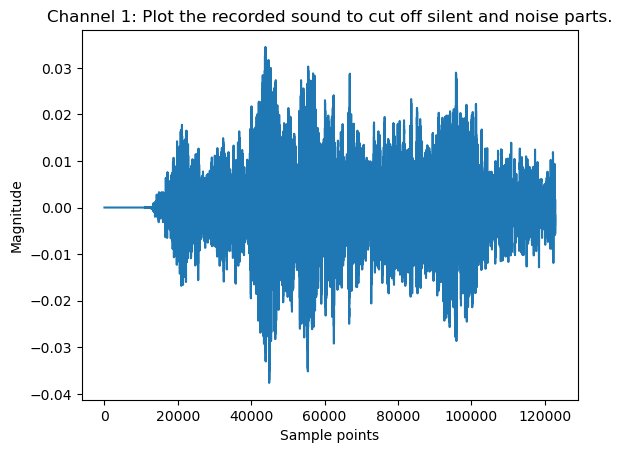

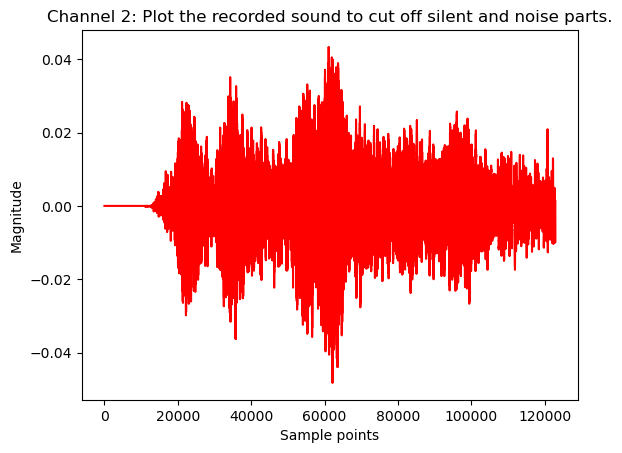

In [30]:
# a, create a chirp sound
# Function that returns a chirp
def make_chirp( duration=1, sample_rate=8000):
    f0 = 0
    f1 = 8000
    c = (f1-f0)/duration
    angle0 = 0
    number_of_sample = duration*sample_rate
    #initialize the sound
    sound = np.zeros(number_of_sample)
    for i in range(sound.size):
        t = i/sample_rate
        angle = angle0+2*np.pi*(c/2*t*t+f0*t)
        sound[i] = np.cos(angle)
    return sound
chirp_duration = 2
chirp_sound = make_chirp(chirp_duration,sample_rate)
play_sound(chirp_sound,sample_rate,"Chirp sound")

# b, record the chirp sound in a quiet room
Recorded_chirp_sound, recorded_sample_rate = sf.read("Recorded_chirp_sound4.wav")
Recorded_chirp_sound = Recorded_chirp_sound.T
play_sound(Recorded_chirp_sound,recorded_sample_rate, "Recorded chirp sound")
plt.plot(Recorded_chirp_sound[0])
plt.xlabel("Sample points")
plt.ylabel("Magnitude")
plt.title("Channel 1: Plot the recorded sound to cut off silent and noise parts.")
plt.figure()
plt.plot(Recorded_chirp_sound[1],'r')
plt.xlabel("Sample points")
plt.ylabel("Magnitude")
plt.title("Channel 2: Plot the recorded sound to cut off silent and noise parts.")
print("It can be seen that the beginning parts are silent and the ending parts are noise")
print("I'll crop them off")
#cropped_recorded_chirp_sound = np.array([Recorded_chirp_sound[0][10000:58000],Recorded_chirp_sound[1][10000:58000]])
cropped_recorded_chirp_sound = np.array([Recorded_chirp_sound[0],Recorded_chirp_sound[1]])
# plt.figure()
# plt.plot(Recorded_chirp_sound[0][12000:60000])
play_sound(cropped_recorded_chirp_sound,recorded_sample_rate,"Cropped recorded chirp sound")


# C: deconvolution

In [38]:
def plot_sound(sound,duration=1,sample_rate=8000):
    t = np.linspace(0,duration,len(sound))
    plt.plot(t,sound)
    plt.xlabel('Time')
    plt.ylabel('Amplitude')
#zero padding
#print("The length of chirp sound: {}, the length of recorded sound: {}".format(len(chirp_sound), len(cropped_chirp_sound[0])))
chirp_sound = np.concatenate([chirp_sound,np.zeros(len(cropped_recorded_chirp_sound[0])-len(chirp_sound))])
#print("Padded chirp sound length:{}".format(len(chirp_sound)))
# DFT
chirp_sound_DFT = np.fft.rfft(chirp_sound)
cropped_chirp_sound1 = np.fft.rfft(cropped_recorded_chirp_sound[0])
cropped_chirp_sound2 = np.fft.rfft(cropped_recorded_chirp_sound[1])
h_chanel1 = cropped_chirp_sound1/chirp_sound_DFT
h_chanel2 = cropped_chirp_sound2/chirp_sound_DFT
# Inverse DFT
room_impulse_response1 = np.fft.irfft(h_chanel1)
room_impulse_response2 = np.fft.irfft(h_chanel2)
room_impulse_response = np.array([room_impulse_response1,room_impulse_response2])
play_sound(room_impulse_response, sample_rate,"Room impulse response")


Room impulse response


In [39]:
sound, sample_rate = sf.read("loop.wav")
convolved_sound = [[],[]]

for i in range(2):
    convolved_sound[i] = np.convolve(room_impulse_response[i],sound)
play_sound(convolved_sound, sample_rate, "Sound reverb applying my own room response")

Sound reverb applying my own room response


I do hear pretty clear reverberation, but I think the reverberation is way too strong and is not close enough to the original sound. It's a little bit like echo.